In [5]:
import pandas as pd
from mordred import Calculator, descriptors
from rdkit import Chem,DataStructs
from rdkit.Chem import AllChem,PandasTools
import rdkit
import numpy as np

In [6]:
df=pd.read_csv(r"C:\Users\19189\Desktop\original_data.csv")

In [7]:
df

,CASRN,CATMoS_LD50_mgkg,Canonical_QSARr,LogLD50
0,68523-18-2,460.000,CC1(C)C(C1C=C(Cl)Cl)C(=O)OC(C#N)C1C=CC=C(N=1)O...,2.662758
1,88-04-0,3830.000,CC1C=C(O)C=C(C)C=1Cl,3.583199
2,603-50-9,4305.000,CC(=O)OC1C=CC(=CC=1)C(C1C=CC=CN=1)C1C=CC(=CC=1...,3.633973
3,120-36-5,689.000,CC(OC1C=CC(Cl)=CC=1Cl)C(O)=O,2.838219
4,103-26-4,2610.000,COC(=O)C=CC1C=CC=CC=1,3.416641
5,54-80-8,900.000,CC(C)NCC(O)C1C=CC2=CC=CC=C2C=1,2.954243
6,51423-20-2,3500.000,COC1=CC2OC(C)(C)C(C(C=2C=C1)C1C=CC(=CC=1)OCCN1...,3.544068
7,69226-50-2,250.000,N#CC1OC1C#N,2.397940
8,105-87-3,6330.000,CC(C)=CCCC(C)=CCOC(C)=O,3.801404
9,77664-07-4,1350.000,COC1C=C(C=C(OC)C=1OC)C=CC(=S)N1CCOCC1,3.130334


In [8]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import make_regression
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn import set_config

In [9]:
def MACCSfp(mol):
    fp = rdkit.Chem.rdMolDescriptors.GetMACCSKeysFingerprint(mol)
    ar = np.zeros((1,), dtype=np.int8)
    DataStructs.ConvertToNumpyArray(fp, ar)
    return ar

,CASRN,CATMoS_LD50_mgkg,Canonical_QSARr,LogLD50,Molecule
0,68523-18-2,460.000,CC1(C)C(C1C=C(Cl)Cl)C(=O)OC(C#N)C1C=CC=C(N=1)O...,2.662758,
1,88-04-0,3830.000,CC1C=C(O)C=C(C)C=1Cl,3.583199,
2,603-50-9,4305.000,CC(=O)OC1C=CC(=CC=1)C(C1C=CC=CN=1)C1C=CC(=CC=1...,3.633973,
3,120-36-5,689.000,CC(OC1C=CC(Cl)=CC=1Cl)C(O)=O,2.838219,
4,103-26-4,2610.000,COC(=O)C=CC1C=CC=CC=1,3.416641,
5,54-80-8,900.000,CC(C)NCC(O)C1C=CC2=CC=CC=C2C=1,2.954243,
6,51423-20-2,3500.000,COC1=CC2OC(C)(C)C(C(C=2C=C1)C1C=CC(=CC=1)OCCN1...,3.544068,
7,69226-50-2,250.000,N#CC1OC1C#N,2.397940,
8,105-87-3,6330.000,CC(C)=CCCC(C)=CCOC(C)=O,3.801404,
9,77664-07-4,1350.000,COC1C=C(C=C(OC)C=1OC)C=CC(=S)N1CCOCC1,3.130334,

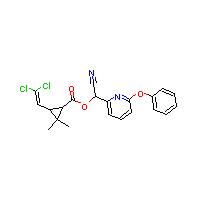
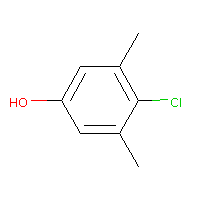
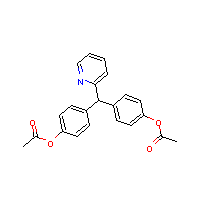
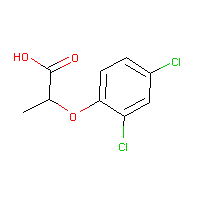
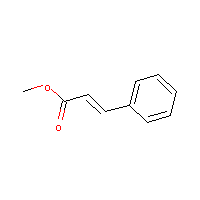
...
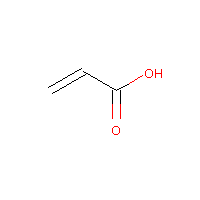
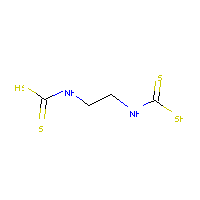
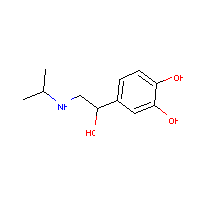
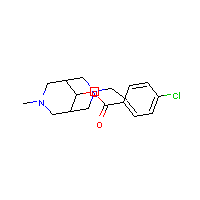
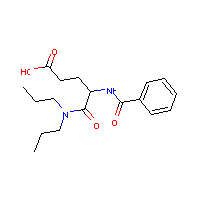

In [10]:
PandasTools.AddMoleculeColumnToFrame(df,'Canonical_QSARr','Molecule')
df

In [11]:
df["MACCSFPs"] =df.Molecule.apply(MACCSfp)
df.head(2)

,CASRN,CATMoS_LD50_mgkg,Canonical_QSARr,LogLD50,Molecule,MACCSFPs
0,68523-18-2,460.0,CC1(C)C(C1C=C(Cl)Cl)C(=O)OC(C#N)C1C=CC=C(N=1)O...,2.662758,<rdkit.Chem.rdchem.Mol object at 0x00000289AED...,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1,88-04-0,3830.0,CC1C=C(O)C=C(C)C=1Cl,3.583199,<rdkit.Chem.rdchem.Mol object at 0x00000289AED...,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."


In [12]:
fp_df = df["MACCSFPs"].apply(pd.Series)
fp_df.head(2)

,0,1,2,3,4,5,6,7,8,9,...,157,158,159,160,161,162,163,164,165,166
0,0,0,0,0,0,0,0,0,0,0,...,1,0,1,1,1,1,1,1,1,0
1,0,0,0,0,0,0,0,0,0,0,...,1,0,0,1,0,1,1,1,1,0


In [13]:
x = fp_df.iloc[:,0:167]
y = df['LogLD50'].values

In [11]:
xtrain, xtest, ytrain, ytest = train_test_split(x, y, test_size=0.25，random_state=42)

In [32]:
rfr = RandomForestRegressor(random_state=42)

In [13]:
score = rfr.score(xtrain, ytrain)
print("R-squared:", score)

ypred = rfr.predict(xtrain)

mse = mean_squared_error(ytrain, ypred)
print("MSE: ", mse)
print("RMSE: ", mse**(1/2.0))

R-squared: 0.922710452119103
MSE:  0.05185036420706935
RMSE:  0.22770675046442815


In [14]:
import numpy as np
import matplotlib.pyplot as plt
x = ytest
y = rfr.predict(xtest)
a, b = np.polyfit(x, y, 1)

#Find axis dimensions for scatter plot
import math
max_dim = math.ceil(max(x.max(),y.max())) +1
min_dim = math.floor(min(x.min(), y.min())) -1

plt.scatter(x, y)
plt.ylim([min_dim, max_dim])
plt.xlim([min_dim, max_dim])
plt.plot(x, a*x+b)
plt.title("LogLD50 Prediction")
plt.xlabel('Test Set LogLD50 Values')
plt.ylabel('Predicted LogLD50 Values')
# The optional line below saves the figure to file as an eps vector graphic as required in many journals.
# If you can't open in try using Acrobat, it will be able to read the postcript.
#plt.savefig('phenethylamine_predictions.eps', format='eps')

Text(0, 0.5, 'Predicted LogLD50 Values')

In [15]:
print("Testset Prediction Performance")
print("------------------------------")
correlation = np.corrcoef(x, y)[0,1]
print("Correlation:", correlation)
#R-square for Test Set results (above is R-square for training results)
rsquare = correlation**2
print("Testset Rsquare:", rsquare)

Testset Prediction Performance
------------------------------
Correlation: 0.7476546196506542
Testset Rsquare: 0.5589874302849643


In [13]:
x = fp_df.iloc[:,0:167]
y = df['LogLD50'].values

In [16]:
import optuna
from sklearn.model_selection import cross_val_score, GridSearchCV, KFold, StratifiedKFold, RandomizedSearchCV, train_test_split

def objective(trial):
    param = {
        "n_estimators":trial.suggest_int("n_estimators", 200, 360, step=20),
        "criterion": trial.suggest_categorical( "criterion", ["squared_error","absolute_error", "friedman_mse"]),
        "min_samples_split": 2,
        "min_samples_leaf":1,
        "max_features": trial.suggest_categorical("max_features", ["sqrt", None]),
        "max_leaf_nodes": trial.suggest_int('max_leaf_nodes',100,1000,step=100),
        "random_state":42
    }
    param["max_depth"] = trial.suggest_int("max_depth",13 , 19, step=2)
    model = RandomForestRegressor(**param)

    R2= cross_val_score(model, x, y, n_jobs=-1, cv=5, scoring="r2").mean()
    mse= cross_val_score(model, x, y, n_jobs=-1, cv=5, scoring="neg_mean_squared_error").mean()
    mse=abs(mse)
    return R2,mse

study = optuna.create_study(
    directions=["maximize","minimize"],
    study_name="rfr_opt",
    pruner = optuna.pruners.MedianPruner(n_warmup_steps=5)
    )

study.optimize(objective, n_trials=100)
df = study.trials_dataframe()
df.to_csv(r'C:\Users\19189\Desktop\MACCS_trial3.csv',index=False)

D:\anaconda3\envs\CATMOS\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
[I 2024-03-16 13:14:54,048] A new study created in memory with name: rfr_opt
[I 2024-03-16 14:33:09,725] Trial 0 finished with values: [0.4530361291994689, 0.3432433842677066] and parameters: {'n_estimators': 320, 'criterion': 'absolute_error', 'max_features': None, 'max_leaf_nodes': 400, 'max_depth': 15}. 
[I 2024-03-16 14:34:15,600] Trial 1 finished with values: [0.4836151352893519, 0.32274074762551114] and parameters: {'n_estimators': 320, 'criterion': 'friedman_mse', 'max_features': None, 'max_leaf_nodes': 700, 'max_depth': 13}. 
[I 2024-03-16 14:35:44,518] Trial 2 finished with values: [0.508871602118021, 0.3073021742250709] and parameters: {'n_estimators': 360, 'criterion': 'squared_error', 'max_features': None, 'max_leaf_nodes': 1000, 

In [17]:
df=pd.read_csv(r'C:\Users\19189\Desktop\MACCS_trial3.csv')
pd.set_option('display.max_rows', None)
df

,number,values_0,values_1,datetime_start,datetime_complete,duration,params_criterion,params_max_depth,params_max_features,params_max_leaf_nodes,params_n_estimators,system_attrs_nsga2:generation,state
0,0,0.453036,0.343243,2024-03-16 13:14:54.050393,2024-03-16 14:33:09.725815,0 days 01:18:15.675422,absolute_error,15,NaN,400,320,0,COMPLETE
1,1,0.483615,0.322741,2024-03-16 14:33:09.726818,2024-03-16 14:34:15.600061,0 days 00:01:05.873243,friedman_mse,13,NaN,700,320,0,COMPLETE
2,2,0.508872,0.307302,2024-03-16 14:34:15.601048,2024-03-16 14:35:44.518601,0 days 00:01:28.917553,squared_error,17,NaN,1000,360,0,COMPLETE
3,3,0.508466,0.307554,2024-03-16 14:35:44.519604,2024-03-16 14:37:02.648741,0 days 00:01:18.129137,squared_error,17,NaN,1000,320,0,COMPLETE
4,4,0.434979,0.352344,2024-03-16 14:37:02.650749,2024-03-16 14:37:35.560792,0 days 00:00:32.910043,squared_error,15,NaN,200,220,0,COMPLETE
5,5,0.432884,0.357032,2024-03-16 14:37:35.561794,2024-03-16 14:44:14.580950,0 days 00:06:39.019156,absolute_error,13,sqrt,800,360,0,COMPLETE
6,6,0.385799,0.383429,2024-03-16 14:44:14.581950,2024-03-16 14:44:53.245059,0 days 00:00:38.663109,friedman_mse,15,NaN,100,320,0,COMPLETE
7,7,0.456638,0.341734,2024-03-16 14:44:53.247060,2024-03-16 14:49:03.221790,0 days 00:04:09.974730,absolute_error,15,sqrt,1000,220,0,COMPLETE
8,8,0.385501,0.383670,2024-03-16 14:49:03.222792,2024-03-16 14:49:32.129817,0 days 00:00:28.907025,squared_error,17,NaN,100,240,0,COMPLETE
9,9,0.431368,0.354437,2024-03-16 14:49:32.130820,2024-03-16 14:49:36.399400,0 days 00:00:04.268580,friedman_mse,19,sqrt,400,240,0,COMPLETE


In [18]:
df_sort=df.sort_values(by='values_0',ascending=False)
df_sort

,number,values_0,values_1,datetime_start,datetime_complete,duration,params_criterion,params_max_depth,params_max_features,params_max_leaf_nodes,params_n_estimators,system_attrs_nsga2:generation,state
2,2,0.508872,0.307302,2024-03-16 14:34:15.601048,2024-03-16 14:35:44.518601,0 days 00:01:28.917553,squared_error,17,NaN,1000,360,0,COMPLETE
64,64,0.508514,0.307517,2024-03-17 01:46:40.248005,2024-03-17 01:47:59.653999,0 days 00:01:19.405994,friedman_mse,17,NaN,1000,320,1,COMPLETE
3,3,0.508466,0.307554,2024-03-16 14:35:44.519604,2024-03-16 14:37:02.648741,0 days 00:01:18.129137,squared_error,17,NaN,1000,320,0,COMPLETE
57,57,0.507310,0.308348,2024-03-16 23:18:45.098017,2024-03-16 23:19:37.789993,0 days 00:00:52.691976,squared_error,17,NaN,1000,200,1,COMPLETE
77,77,0.503695,0.310279,2024-03-17 04:42:27.624780,2024-03-17 04:43:32.372866,0 days 00:01:04.748086,squared_error,17,NaN,800,280,1,COMPLETE
40,40,0.503334,0.310519,2024-03-16 19:27:57.352143,2024-03-16 19:28:59.844664,0 days 00:01:02.492521,squared_error,17,NaN,800,240,0,COMPLETE
54,54,0.503334,0.310519,2024-03-16 21:42:59.228550,2024-03-16 21:44:01.895681,0 days 00:01:02.667131,squared_error,17,NaN,800,240,1,COMPLETE
91,91,0.502217,0.311392,2024-03-17 07:20:20.368922,2024-03-17 07:21:47.664413,0 days 00:01:27.295491,squared_error,15,NaN,1000,360,1,COMPLETE
30,30,0.502098,0.311430,2024-03-16 16:26:51.250803,2024-03-16 16:28:15.641549,0 days 00:01:24.390746,friedman_mse,15,NaN,1000,360,0,COMPLETE
96,96,0.500683,0.312238,2024-03-17 07:23:50.896583,2024-03-17 07:25:05.443695,0 days 00:01:14.547112,friedman_mse,15,NaN,900,320,1,COMPLETE


In [19]:
import optuna
from sklearn.model_selection import cross_val_score, GridSearchCV, KFold, StratifiedKFold, RandomizedSearchCV, train_test_split

def objective(trial):
    param = {
        "n_estimators":trial.suggest_int("n_estimators", 200, 360, step=20),
        "criterion": trial.suggest_categorical( "criterion", ["squared_error","absolute_error", "friedman_mse"]),
        "min_samples_split": trial.suggest_int("min_samples_split",2,20,step=2),
        "min_samples_leaf": trial.suggest_int("min_samples_leaf",1,9,step=2),
        "max_features":None,
        "max_leaf_nodes": trial.suggest_int('max_leaf_nodes',600,2000,step=200),
        "random_state":42
    }
    param["max_depth"] = 17
    model = RandomForestRegressor(**param)

    R2= cross_val_score(model, x, y, n_jobs=-1, cv=5, scoring="r2").mean()
    mse= cross_val_score(model, x, y, n_jobs=-1, cv=5, scoring="neg_mean_squared_error").mean()
    mse=abs(mse)
    return R2,mse

study = optuna.create_study(
    directions=["maximize","minimize"],
    study_name="rfr_opt",
    pruner = optuna.pruners.MedianPruner(n_warmup_steps=5)
    )

study.optimize(objective, n_trials=100)
df = study.trials_dataframe()
df.to_csv(r'C:\Users\19189\Desktop\MACCS_trial4.csv',index=False)

[I 2024-03-17 10:47:13,777] A new study created in memory with name: rfr_opt
[I 2024-03-17 10:48:16,056] Trial 0 finished with values: [0.4882240889477966, 0.3206268628980933] and parameters: {'n_estimators': 260, 'criterion': 'friedman_mse', 'min_samples_split': 14, 'min_samples_leaf': 1, 'max_leaf_nodes': 1000}. 
[I 2024-03-17 12:05:43,196] Trial 1 finished with values: [0.42492033003691443, 0.3631970069625279] and parameters: {'n_estimators': 320, 'criterion': 'absolute_error', 'min_samples_split': 8, 'min_samples_leaf': 9, 'max_leaf_nodes': 1000}. 
[I 2024-03-17 12:06:57,796] Trial 2 finished with values: [0.49696354294414996, 0.31491092238835383] and parameters: {'n_estimators': 320, 'criterion': 'friedman_mse', 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_leaf_nodes': 800}. 
[I 2024-03-17 13:24:45,396] Trial 3 finished with values: [0.4222950455906259, 0.364916155738954] and parameters: {'n_estimators': 320, 'criterion': 'absolute_error', 'min_samples_split': 20, 'min_sam

In [21]:
df=pd.read_csv(r'C:\Users\19189\Desktop\MACCS_trial4.csv')
pd.set_option('display.max_rows', None)
df

,number,values_0,values_1,datetime_start,datetime_complete,duration,params_criterion,params_max_leaf_nodes,params_min_samples_leaf,params_min_samples_split,params_n_estimators,system_attrs_nsga2:generation,state
0,0,0.488224,0.320627,2024-03-17 10:47:13.778704,2024-03-17 10:48:16.056140,0 days 00:01:02.277436,friedman_mse,1000,1,14,260,0,COMPLETE
1,1,0.424920,0.363197,2024-03-17 10:48:16.057143,2024-03-17 12:05:43.196556,0 days 01:17:27.139413,absolute_error,1000,9,8,320,0,COMPLETE
2,2,0.496964,0.314911,2024-03-17 12:05:43.197709,2024-03-17 12:06:57.796472,0 days 00:01:14.598763,friedman_mse,800,1,10,320,0,COMPLETE
3,3,0.422295,0.364916,2024-03-17 12:06:57.796626,2024-03-17 13:24:45.396540,0 days 01:17:47.599914,absolute_error,1400,9,20,320,0,COMPLETE
4,4,0.505515,0.309466,2024-03-17 13:24:45.396540,2024-03-17 13:25:44.576232,0 days 00:00:59.179692,friedman_mse,1000,1,6,240,0,COMPLETE
5,5,0.484089,0.323954,2024-03-17 13:25:44.576232,2024-03-17 13:26:58.111254,0 days 00:01:13.535022,squared_error,1200,3,14,360,0,COMPLETE
6,6,0.484075,0.324146,2024-03-17 13:26:58.111524,2024-03-17 13:27:59.333581,0 days 00:01:01.222057,friedman_mse,800,5,6,300,0,COMPLETE
7,7,0.450556,0.345177,2024-03-17 13:27:59.333581,2024-03-17 13:28:41.789097,0 days 00:00:42.455516,squared_error,600,9,8,240,0,COMPLETE
8,8,0.458926,0.340094,2024-03-17 13:28:41.789097,2024-03-17 13:29:28.615358,0 days 00:00:46.826261,friedman_mse,1000,7,18,260,0,COMPLETE
9,9,0.424138,0.363718,2024-03-17 13:29:28.615358,2024-03-17 14:15:51.510516,0 days 00:46:22.895158,absolute_error,800,9,4,200,0,COMPLETE


In [22]:
df_sort=df.sort_values(by='values_0',ascending=False)
df_sort

,number,values_0,values_1,datetime_start,datetime_complete,duration,params_criterion,params_max_leaf_nodes,params_min_samples_leaf,params_min_samples_split,params_n_estimators,system_attrs_nsga2:generation,state
19,19,0.512276,0.305267,2024-03-17 17:15:19.819964,2024-03-17 17:16:47.536003,0 days 00:01:27.716039,friedman_mse,1400,1,2,320,0,COMPLETE
67,67,0.508366,0.307866,2024-03-18 11:26:41.972825,2024-03-18 11:28:00.491449,0 days 00:01:18.518624,squared_error,1800,1,6,320,1,COMPLETE
92,92,0.507603,0.308329,2024-03-18 16:24:55.706193,2024-03-18 16:25:56.933380,0 days 00:01:01.227187,squared_error,1800,1,6,220,1,COMPLETE
4,4,0.505515,0.309466,2024-03-17 13:24:45.396540,2024-03-17 13:25:44.576232,0 days 00:00:59.179692,friedman_mse,1000,1,6,240,0,COMPLETE
37,37,0.502884,0.311981,2024-03-18 01:58:56.153843,2024-03-18 02:00:18.391875,0 days 00:01:22.238032,squared_error,2000,3,6,320,0,COMPLETE
57,57,0.502604,0.312116,2024-03-18 08:46:53.216423,2024-03-18 08:48:03.375564,0 days 00:01:10.159141,friedman_mse,1600,3,2,280,1,COMPLETE
63,63,0.502463,0.312319,2024-03-18 10:05:03.097456,2024-03-18 10:05:54.761630,0 days 00:00:51.664174,friedman_mse,1400,3,6,220,1,COMPLETE
55,55,0.499493,0.313931,2024-03-18 08:44:43.468143,2024-03-18 08:45:44.108986,0 days 00:01:00.640843,friedman_mse,800,3,4,260,1,COMPLETE
34,34,0.499454,0.313981,2024-03-17 23:37:03.724265,2024-03-17 23:37:58.011307,0 days 00:00:54.287042,friedman_mse,800,3,4,240,0,COMPLETE
82,82,0.498353,0.314112,2024-03-18 15:04:07.927266,2024-03-18 15:05:10.314611,0 days 00:01:02.387345,friedman_mse,1000,1,10,260,1,COMPLETE


In [23]:
d=df_sort.iloc[0]
row=d.to_dict()
row

{'number': 19,
 'values_0': 0.512275953771228,
 'values_1': 0.3052674369725167,
 'datetime_start': '2024-03-17 17:15:19.819964',
 'datetime_complete': '2024-03-17 17:16:47.536003',
 'duration': '0 days 00:01:27.716039',
 'params_criterion': 'friedman_mse',
 'params_max_leaf_nodes': 1400,
 'params_min_samples_leaf': 1,
 'params_min_samples_split': 2,
 'params_n_estimators': 320,
 'system_attrs_nsga2:generation': 0,
 'state': 'COMPLETE'}

In [43]:
params={
 'criterion': 'friedman_mse',
 'max_leaf_nodes': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'max_features': None,
 'n_estimators': 500,
 'max_depth' : 17,
 'random_state':42}

In [44]:
rfr_optimized = RandomForestRegressor(**params)

In [45]:
R2= cross_val_score(rfr_optimized, x, y, n_jobs=-1, cv=5, scoring="r2").mean()
R2

0.5142917236161861

In [35]:
rfr = RandomForestRegressor(random_state=42)

In [36]:
r2= cross_val_score(rfr, x, y, n_jobs=-1, cv=5, scoring="r2").mean()
r2

0.517423352382097